# DATA620 - Project 2
## Team Members
* Simon Ustoyev
* Elina Azrilyan
* Jack Russo
* Anil Akyildir

## Requirements
1. Identify a large 2-node network dataset.  Your data should meet the criteria that it consists of ties between and not within two (or more) distinct groups.
2. Reduce the size of the network using a method such as the island method described in chapter 4 of social network analysis.
3. What can you infer about each of the distinct groups?


In [1]:
# Load Packages
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import numpy as np
from pylab import rcParams
import networkx.algorithms.bipartite as bi

In [2]:
# read Company file
dfc = pd.read_csv('http://www.boardsandgender.com/data/data_companies.txt', delim_whitespace=True, header=None)

# Prepend Company ID with 'C' to avoid collision with Person ID
dfc[0] = 'C' + dfc[0].astype(str)
dfc.head()

,0,1,2,3
0,C1,879447992,24SEVENOFFICE ASA,0667 OSLO
1,C2,990031479,A-COM NORGE ASA,0355 OSLO
2,C3,890687792,ABERDEEN EIENDOMSFOND ASIA ASA,0230 OSLO
3,C4,989761390,ABERDEEN EIENDOMSFOND NORDEN/BALTIKUM ASA,0255 OSLO
4,C5,988671258,ABERDEEN EIENDOMSFOND NORGE II ASA,0255 OSLO


In [3]:
# number of companies (boards)
len(dfc)

384

In [4]:
# read People file
dfp = pd.read_csv('http://www.boardsandgender.com/data/data_people.txt',
                  delim_whitespace=True, header='infer', encoding='cp865')

# Prepend Person ID with 'P' to avoid collision with Company ID
dfp['id'] = 'P' + dfp['id'].astype(str)
dfp.head()

,id,name,gender
0,P1,Aage Jakobsen,1
1,P2,Aage Johan Rem°y,1
2,P3,Aage Rasmus Bjelland Figenschou,1
3,P4,Aagot Irene Skjeldal,2
4,P5,Aase Gundersen,2


In [5]:
# number of people
len(dfp)

5767

In [7]:
# read the Affiliation file - of directors to boards (two-mode network) [as of AUG-2011]
dfcp = pd.read_csv('http://www.boardsandgender.com/data/net2m/net2m_2011-08-01.txt',
                   delim_whitespace=True, header=None, names=['target', 'source'])
dfcp['target'] = 'C' + dfcp['target'].astype(str) # Prepend Company ID with 'C'
dfcp['source'] = 'P' + dfcp['source'].astype(str) # Prepend Person ID with 'P'
dfcp.head()

,target,source
0,C1,P2149
1,C1,P2910
2,C1,P3684
3,C1,P3754
4,C2,P766


In [8]:
# number of affiliations
len(dfcp)

1746

In [9]:
# Creating Graph object from affiliations
B = nx.from_pandas_edgelist(dfcp)

# Check if Graph is 'bipartite'
bi.is_bipartite(B)

True

### Draw board of directors graph
* Orange hexagons represent people
* Blue nodes represent company boards

In [10]:
# Get list of "Person ID" nodes
idp = dfcp['source'].unique()

# Get list of "Company ID" nodes
idc = dfcp['target'].unique()

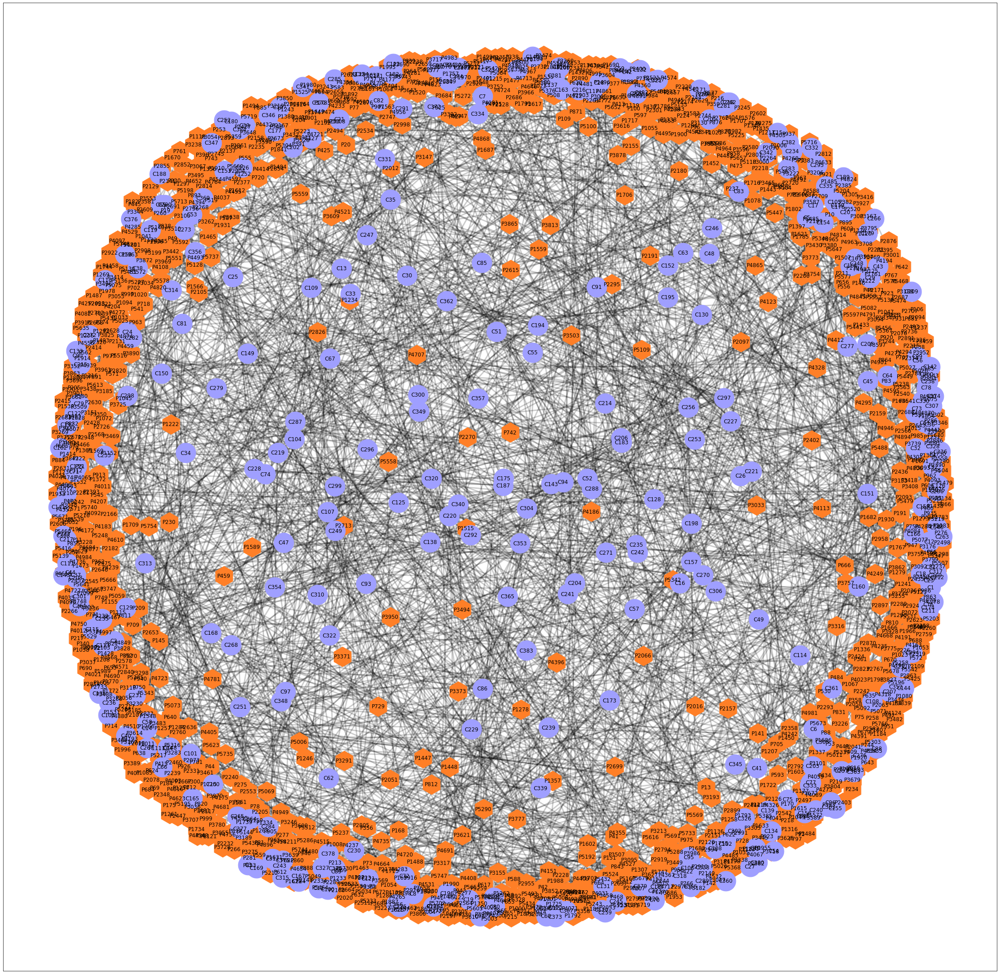

In [11]:
# Draw 2-node affiliation graph
plt.figure(figsize=(40,40))
pos = nx.spring_layout(B, k = 0.7) # Calculate layout
edg = nx.draw_networkx_edges(B, pos, width = 3, alpha = 0.2)
pnd = nx.draw_networkx_nodes(B, pos, nodelist=idp, node_color = "#ff7f27", node_shape = "h", node_size = 2000)
cnd = nx.draw_networkx_nodes(B, pos, nodelist=idc, node_color = "#9f9fff", node_size = 2000)
lbl = nx.draw_networkx_labels(B, pos)

In [25]:
# read numeric ID values from the Affiliation file
idcp = pd.read_csv('http://www.boardsandgender.com/data/net2m/net2m_2011-08-01.txt',
                   delim_whitespace=True, header=None, names=['Company', 'Person'])

In [26]:
# Order by number of People affiliations for each Company
idcp.groupby('Company').count().sort_values('Person', ascending=False)

,Person
Company,
331,12
227,11
244,10
57,10
220,10
...,...
283,3
384,3
364,2


In [27]:
# Order by number of Company affiliations for each Person
idcp.groupby('Person').count().sort_values('Company', ascending=False)

,Company
Person,
3777,8
2066,7
5342,6
5134,6
1047,6
...,...
1914,1
1910,1
1900,1


### Projection Graphs

Person-to-person [unweighted] co-affiliation network

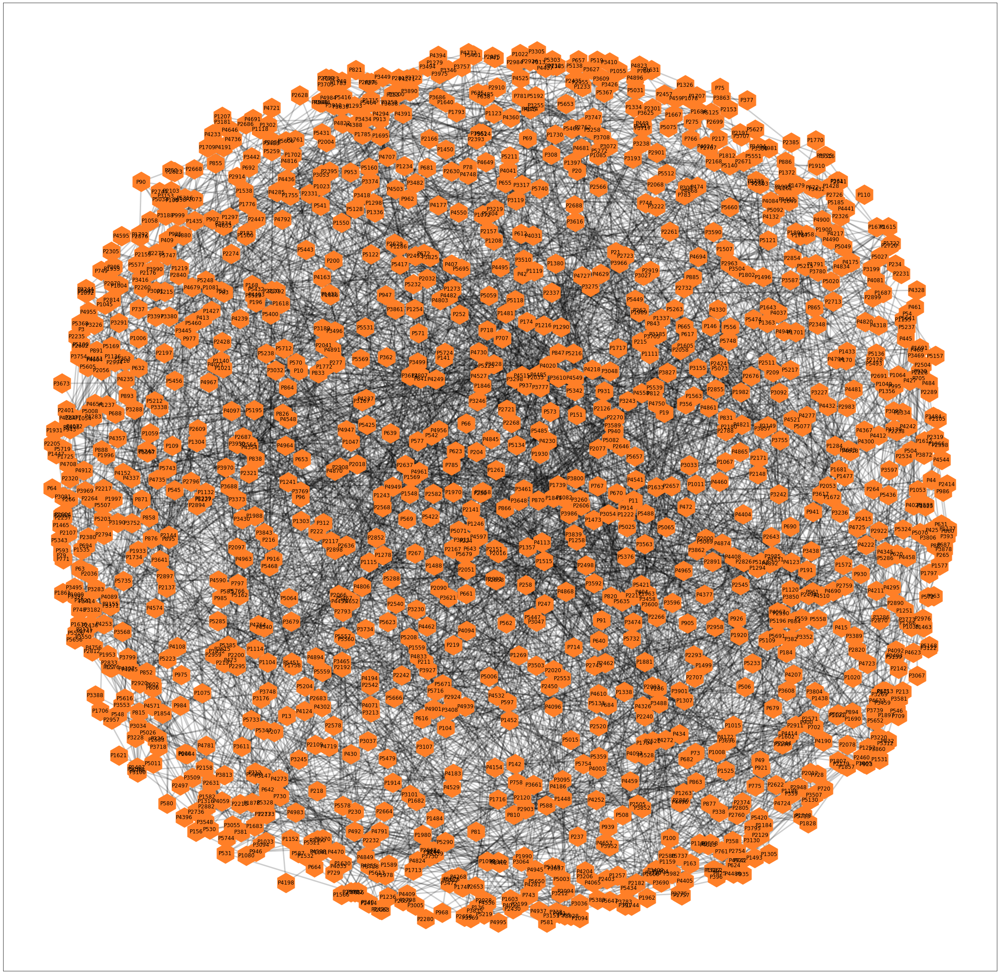

In [31]:
pG = bi.projected_graph(B, idp)
plt.figure(figsize=(40, 40))
pos = nx.spring_layout(pG, k = 0.5)
edg = nx.draw_networkx_edges(pG, pos, width = 3, alpha = 0.2)
pnd = nx.draw_networkx_nodes(pG, pos,node_color = "#ff7f27", node_shape = "h", node_size = 2000)
lbl = nx.draw_networkx_labels(pG, pos, font_size = 12)

Company-to-company [unweighted] co-affiliation network

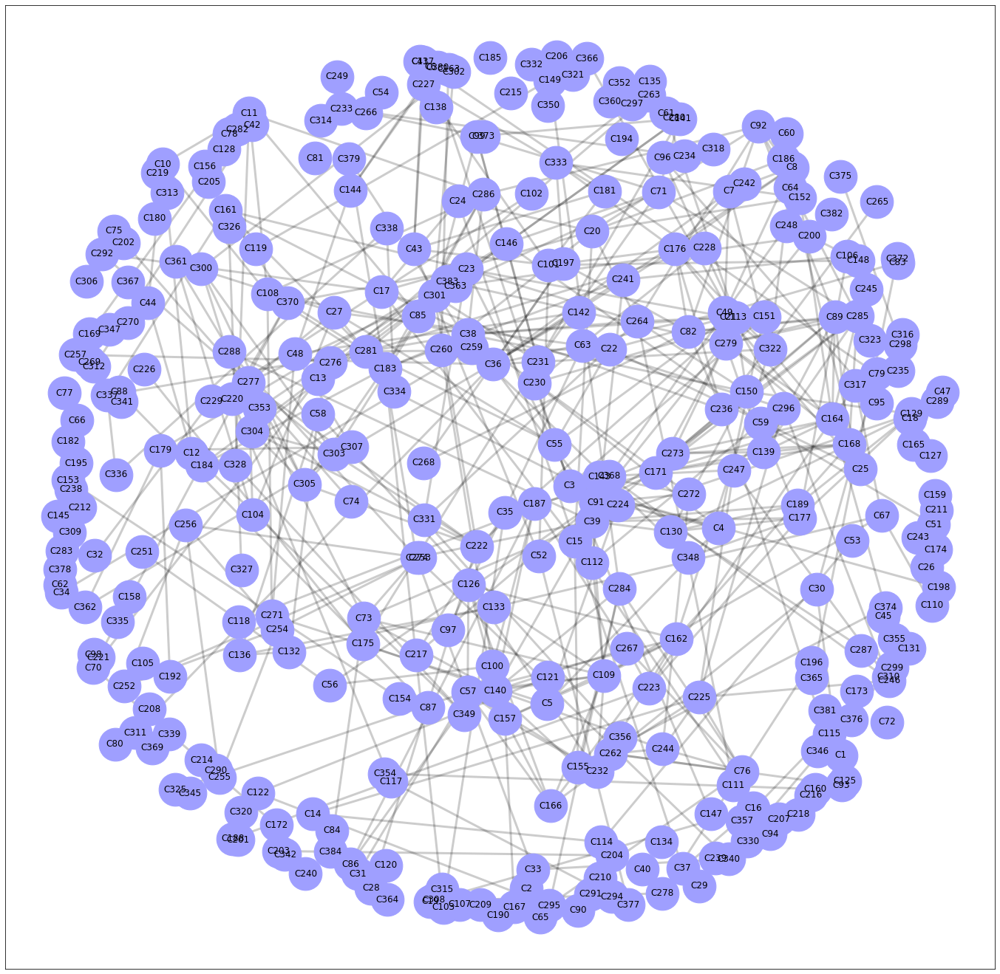

In [32]:
cG = bi.projected_graph(B, idc)
plt.figure(figsize=(24, 24))
pos = nx.spring_layout(cG, k = 0.5)
edg = nx.draw_networkx_edges(cG, pos, width = 3, alpha = 0.2)
pnd = nx.draw_networkx_nodes(cG, pos,node_color = "#9f9fff", node_size = 2000)
lbl = nx.draw_networkx_labels(cG, pos, font_size = 12)

Person-to-person [weighted] co-affiliation network

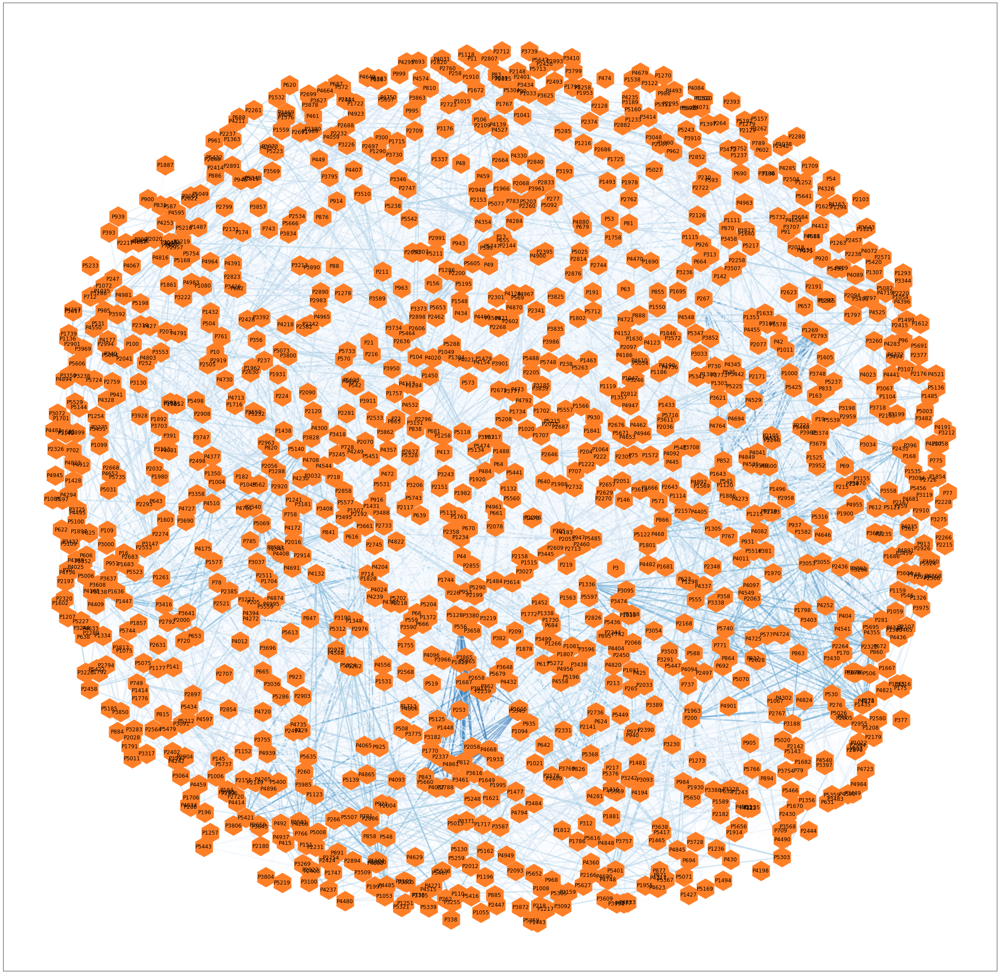

In [34]:
# Create weighted co-affiliation network
wpG = bi.weighted_projected_graph(pG, idp)

# Get weights
w = np.array([wpG.edges[e]['weight'] for e in wpG.edges])

# Create figure
plt.figure(figsize=(40,40))

# Calculate layout
pos = nx.spring_layout(wpG, k = 0.7)

# Draw edges, nodes, and labels
edg = nx.draw_networkx_edges(wpG, pos, width = 3, alpha = 0.5, edge_color = w, edge_cmap=plt.cm.Blues)
pnd = nx.draw_networkx_nodes(wpG, pos, node_color = "#ff7f27", node_shape = "h", node_size = 2000)
lbl = nx.draw_networkx_labels(wpG, pos)

Company-to-company [weighted] co-affiliation network

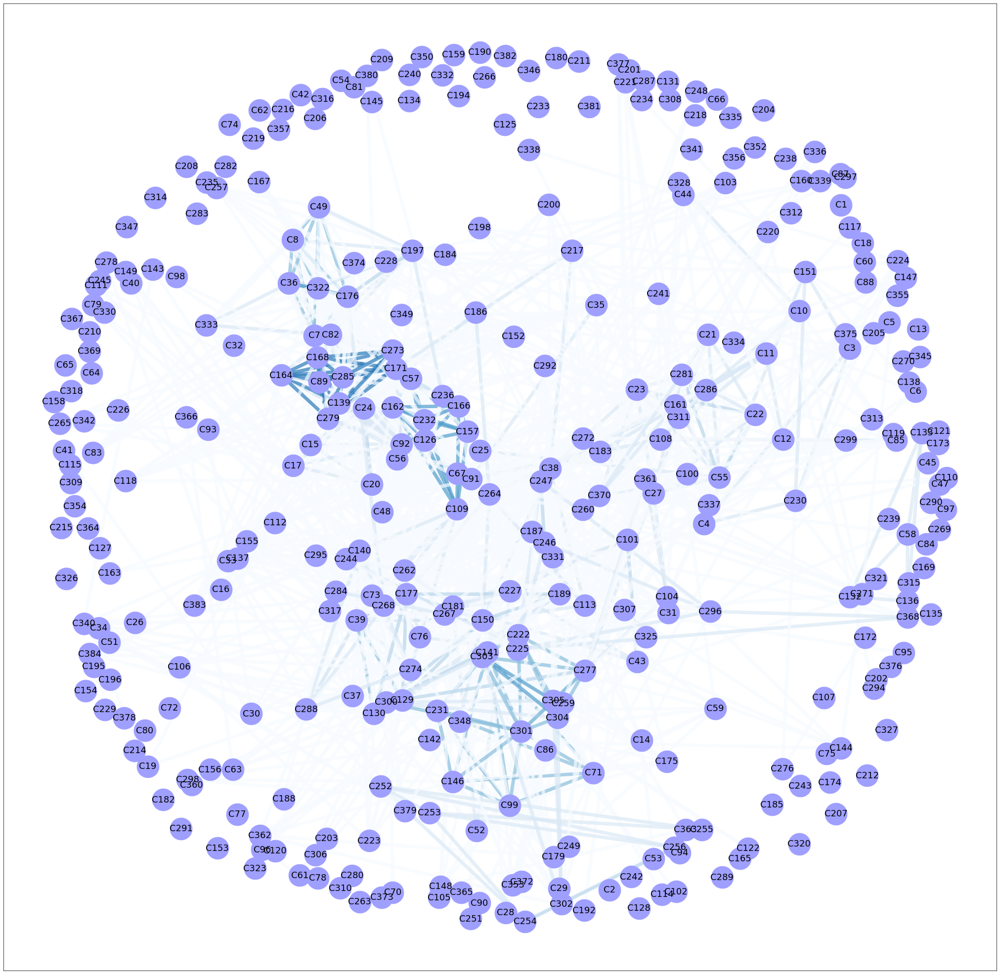

In [36]:
# Create co-affiliation network
wcG = bi.weighted_projected_graph(cG, idc)

# Get weights
w = np.array([wcG.edges[e]['weight'] for e in wcG.edges])

# Create figure
plt.figure(figsize=(36,36))

# Calculate layout
pos = nx.spring_layout(wcG, k = 0.7)

# Draw edges, nodes, and labels
edg = nx.draw_networkx_edges(wcG, pos, width = 7, alpha = 0.7, edge_color = w, edge_cmap=plt.cm.Blues)
pnd = nx.draw_networkx_nodes(wcG, pos, node_color = "#9f9fff", node_size = 2000)
lbl = nx.draw_networkx_labels(wcG, pos, font_size = 18)

In [44]:
def trim_edges(g, weight=1):
    g2 = nx.Graph()
    for f, to, edata in g.edges(data=True):
        if edata['weight'] > weight:
            g2.add_edge(f, to, weight = edata['weight'])
    return g2

def island_method(g, iterations=5):
    weights= [edata['weight'] for f,to,edata in g.edges(data=True)]
    mn=int(min(weights))
    mx=int(max(weights))
    #compute the size of the step, so we get a reasonable step in iterations
    step=int((mx-mn)/iterations)
    return [[threshold, trim_edges(g, threshold)] for threshold in range(mn,mx,step)]
    
def plot_person_node_graph(g):
    plt.figure(figsize=(40, 40))
    pos = nx.spring_layout(g, k = 0.5)
    edg = nx.draw_networkx_edges(g, pos, width = 3, alpha = 0.2)
    pnd = nx.draw_networkx_nodes(g, pos,node_color = "#ff7f27", node_shape = "h", node_size = 2000)
    lbl = nx.draw_networkx_labels(g, pos, font_size = 12)

def plot_company_node_graph(g):
    plt.figure(figsize=(24, 24))
    pos = nx.spring_layout(g, k = 0.5)
    edg = nx.draw_networkx_edges(g, pos, width = 3, alpha = 0.2)
    pnd = nx.draw_networkx_nodes(g, pos, node_color = "#9f9fff", node_size = 1000)
    lbl = nx.draw_networkx_labels(g, pos, font_size = 12)

1 1207 73
3 671 50
5 230 27
7 89 14
9 27 8
11 6 3


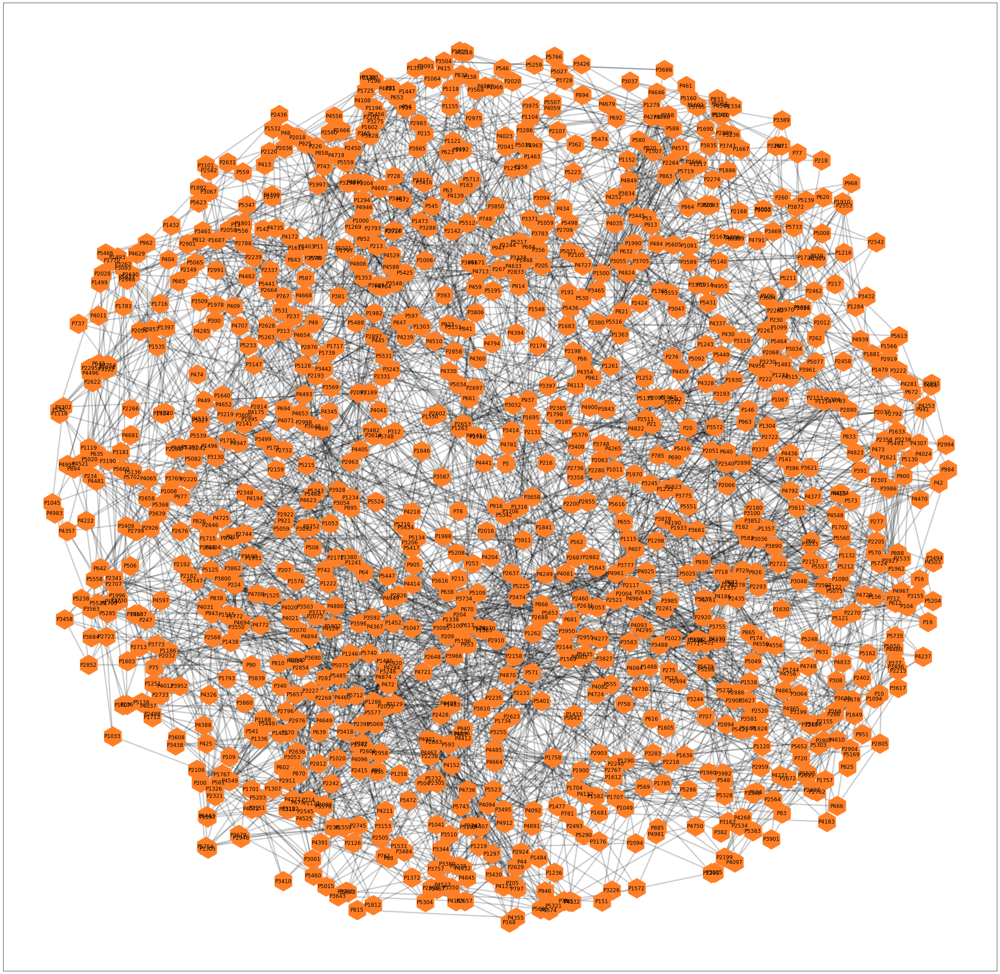

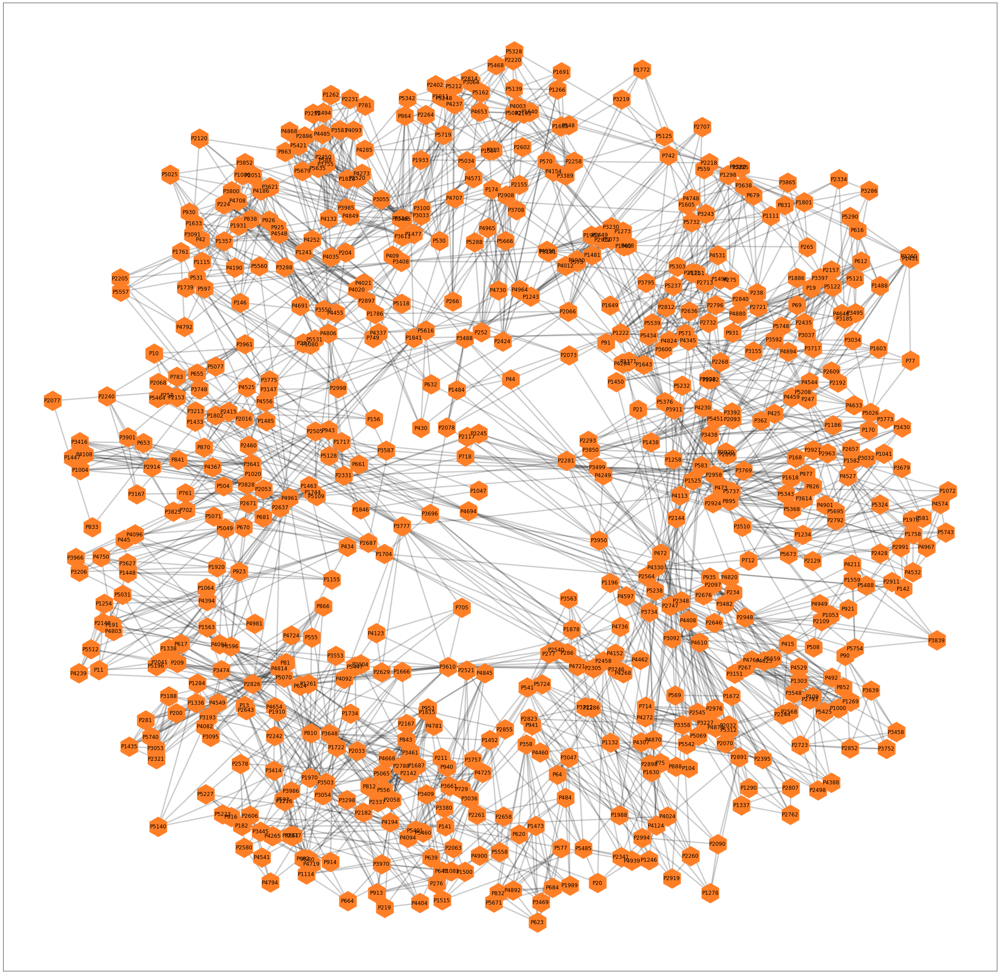

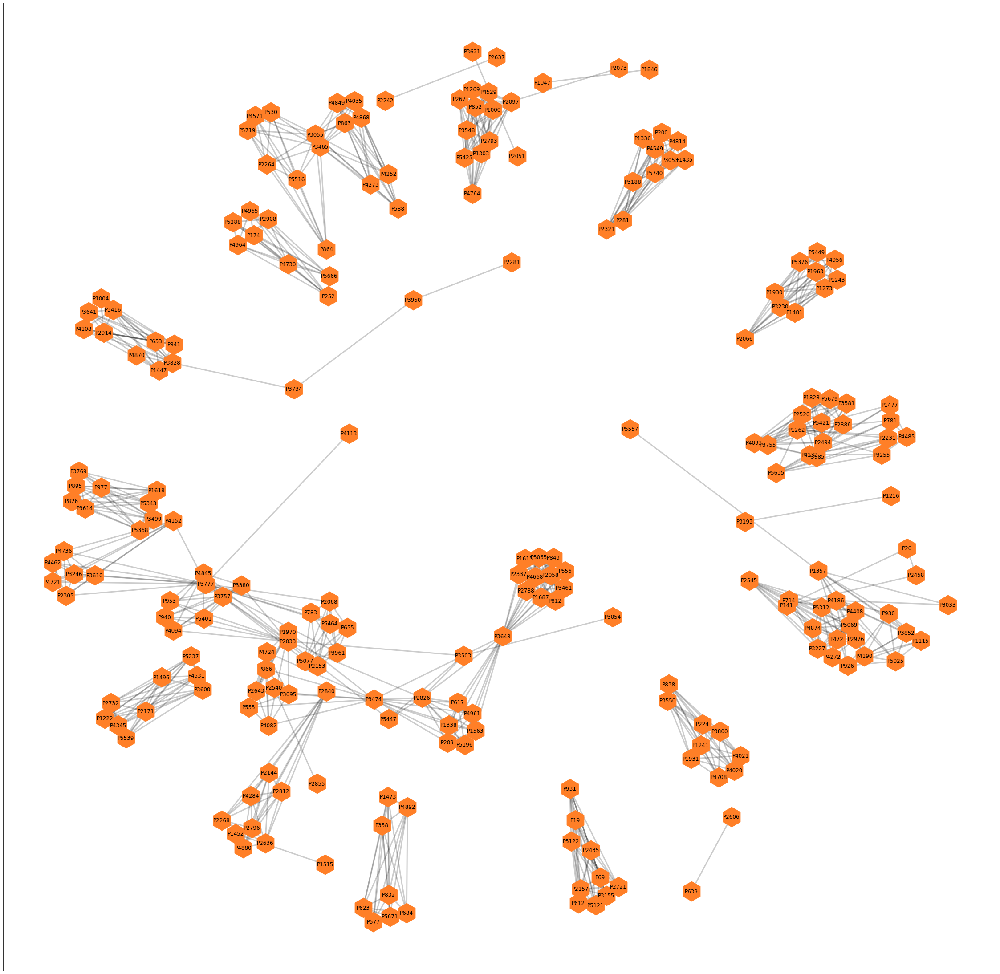

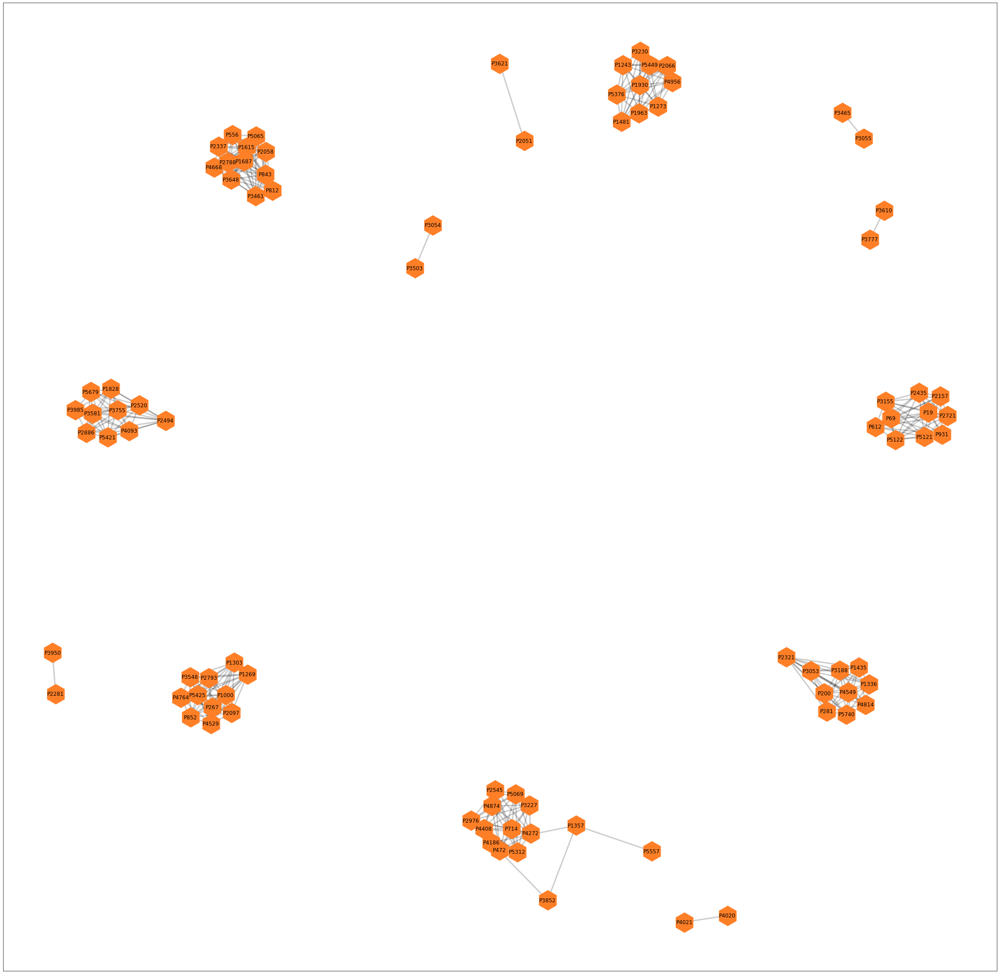

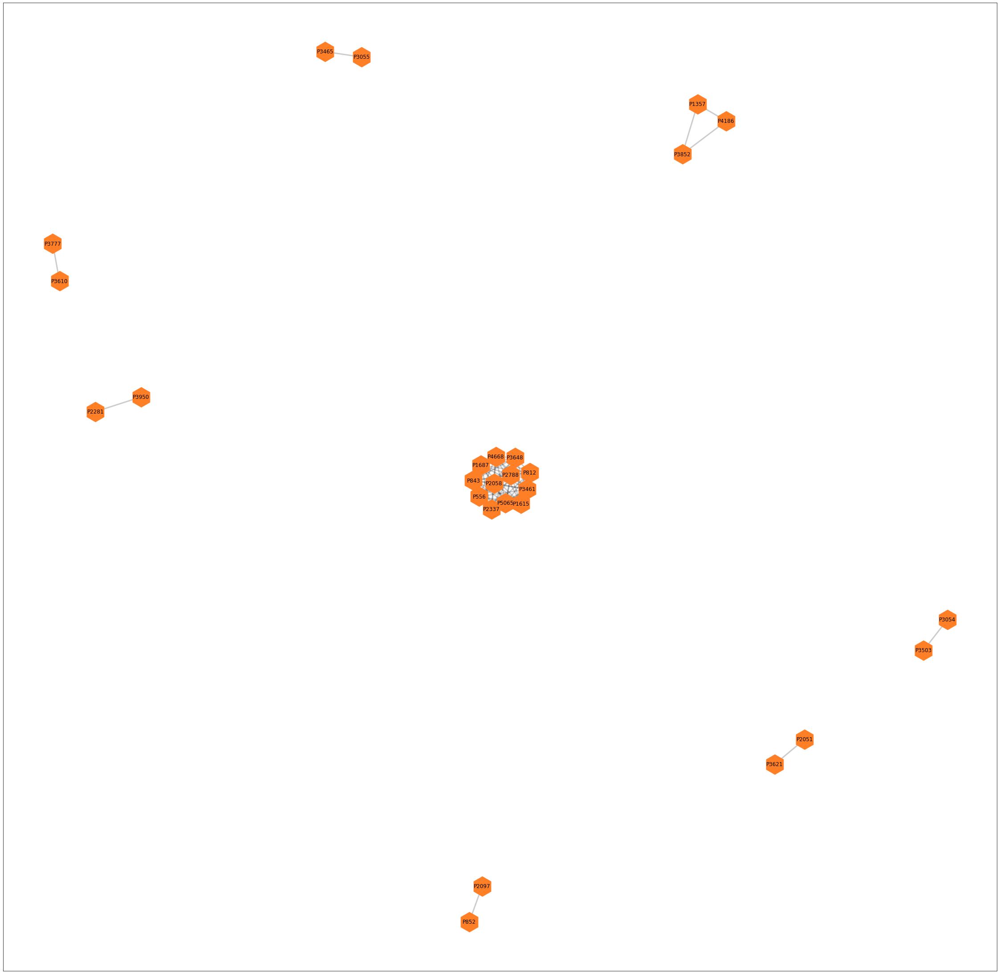

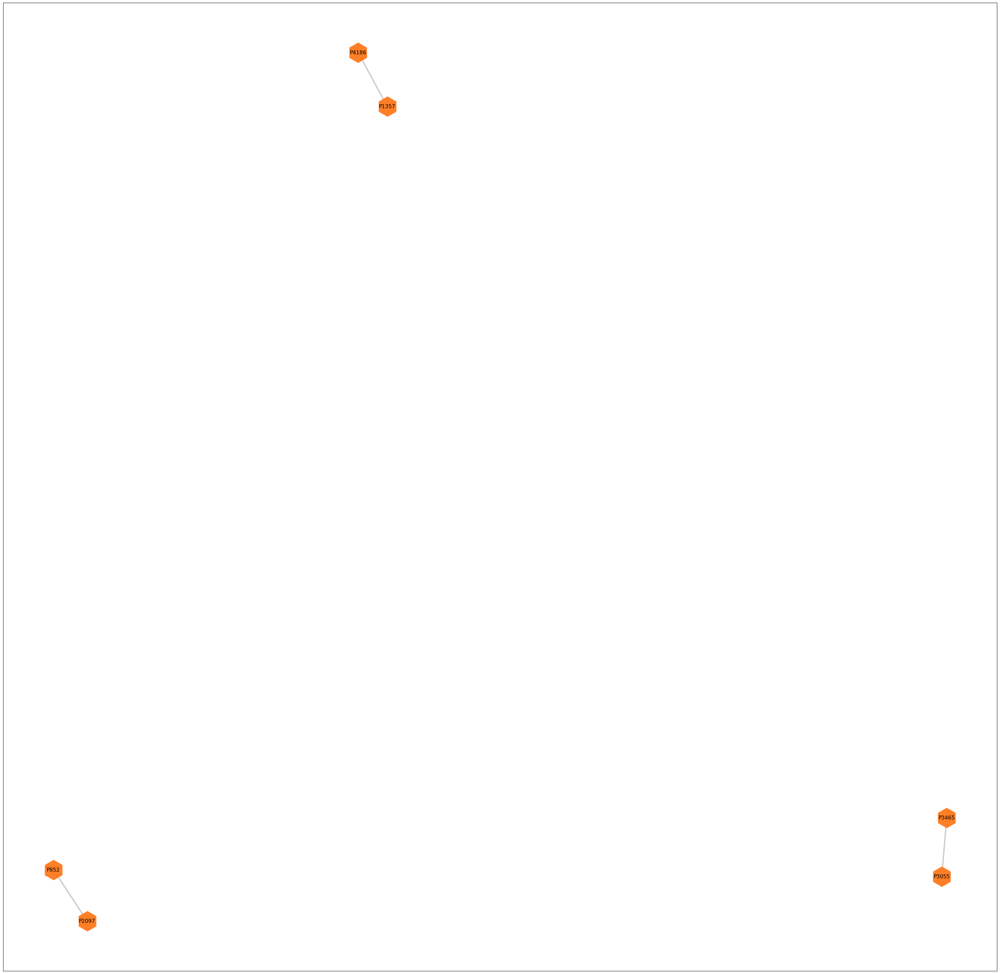

In [45]:
islands = island_method(wpG)
for i in islands:
    # print the threshold level, size of the graph, and number of connected components
    print(i[0], len(i[1]), len(list(nx.connected_components(i[1]))))
    plot_person_node_graph(i[1])

1 109 6
2 57 11
3 37 5
4 20 4
5 8 1
6 4 2
7 2 1


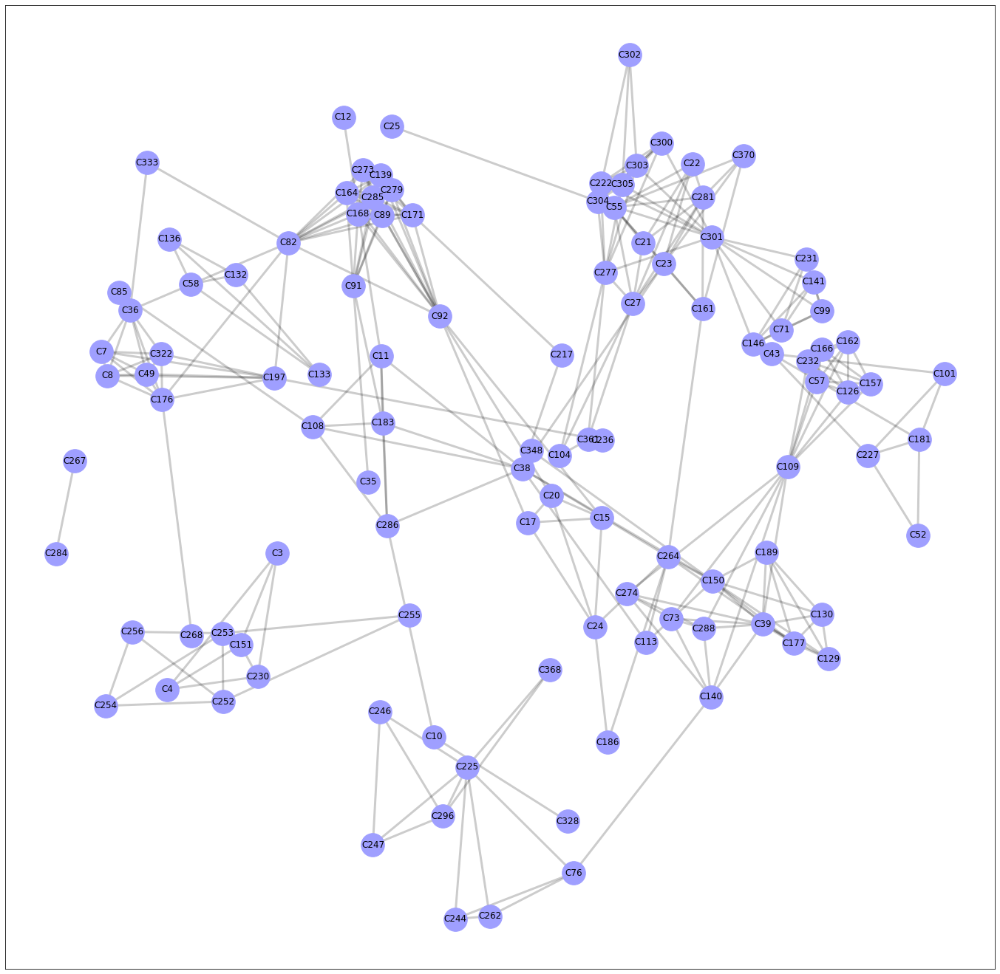

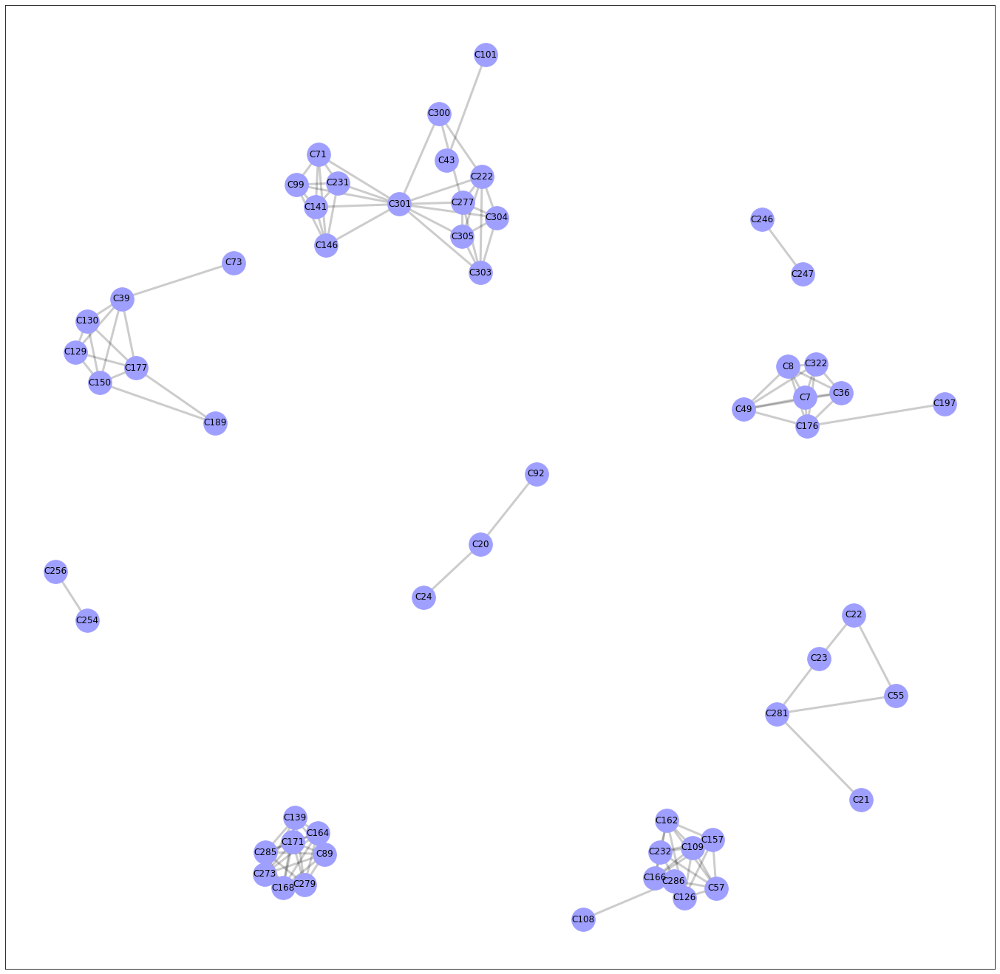

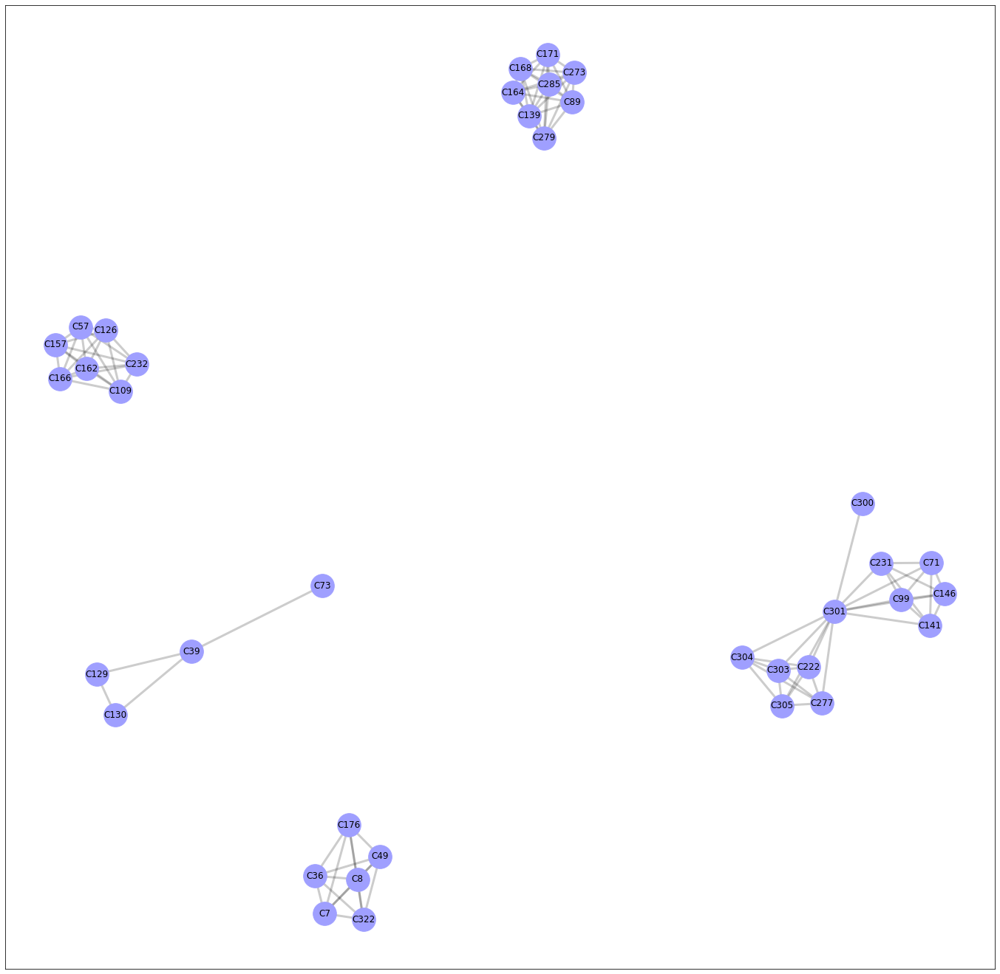

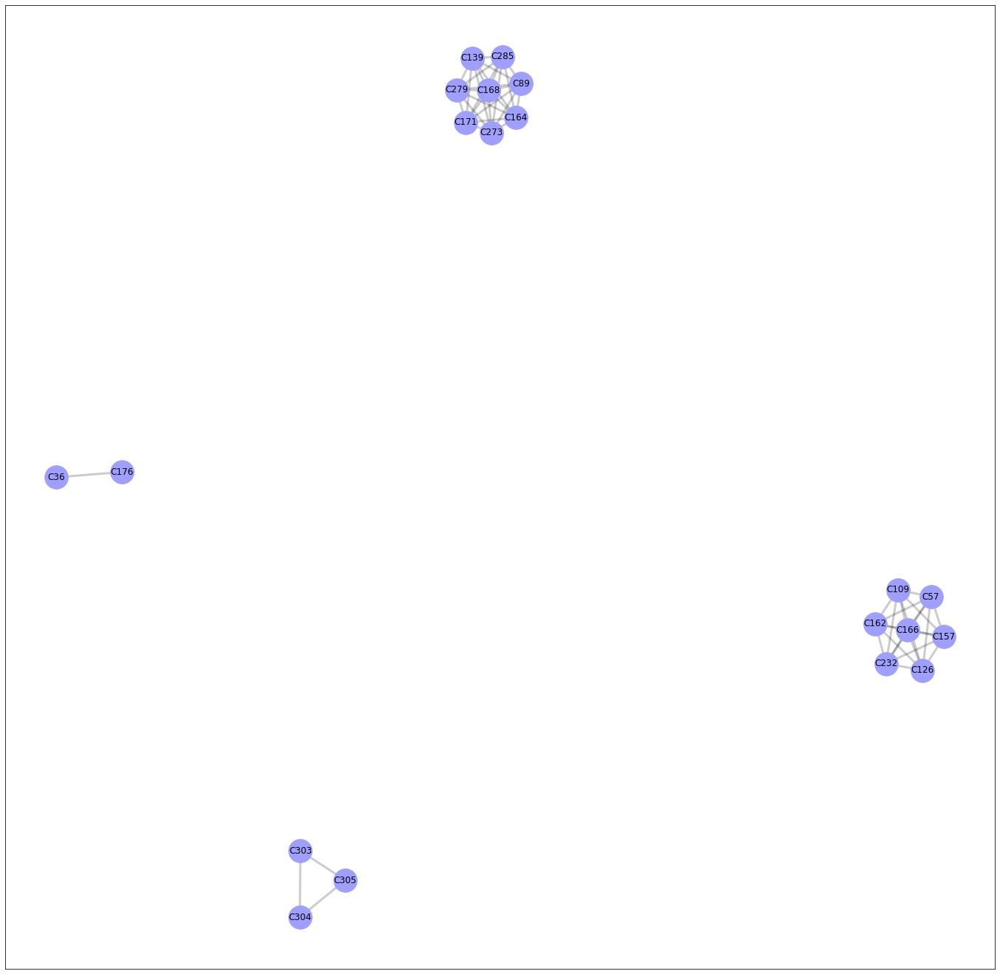

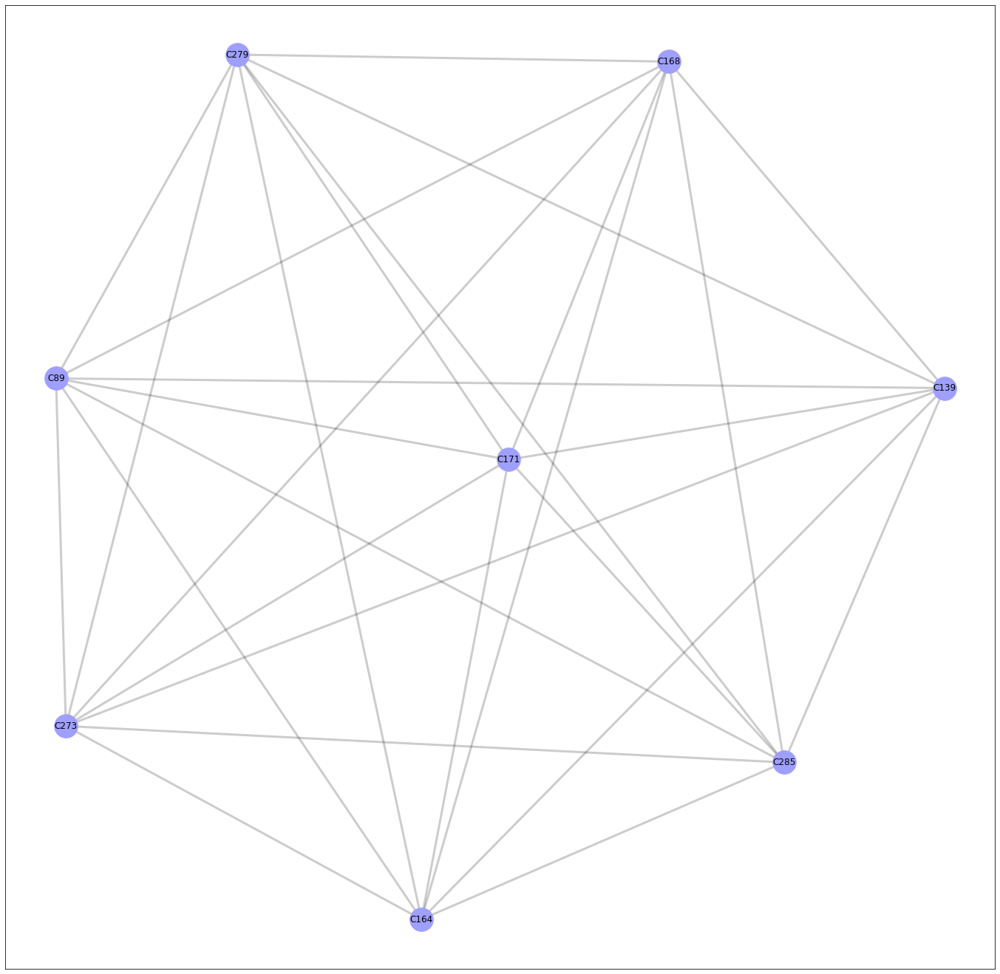

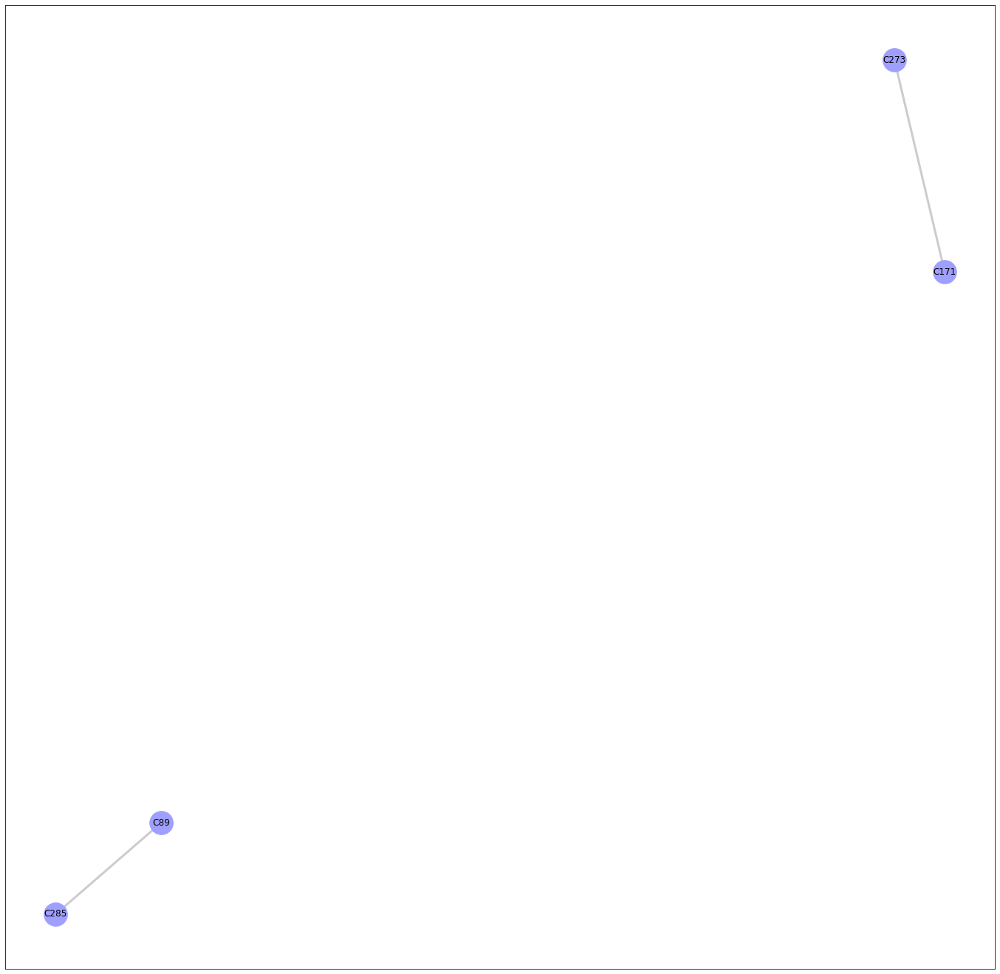

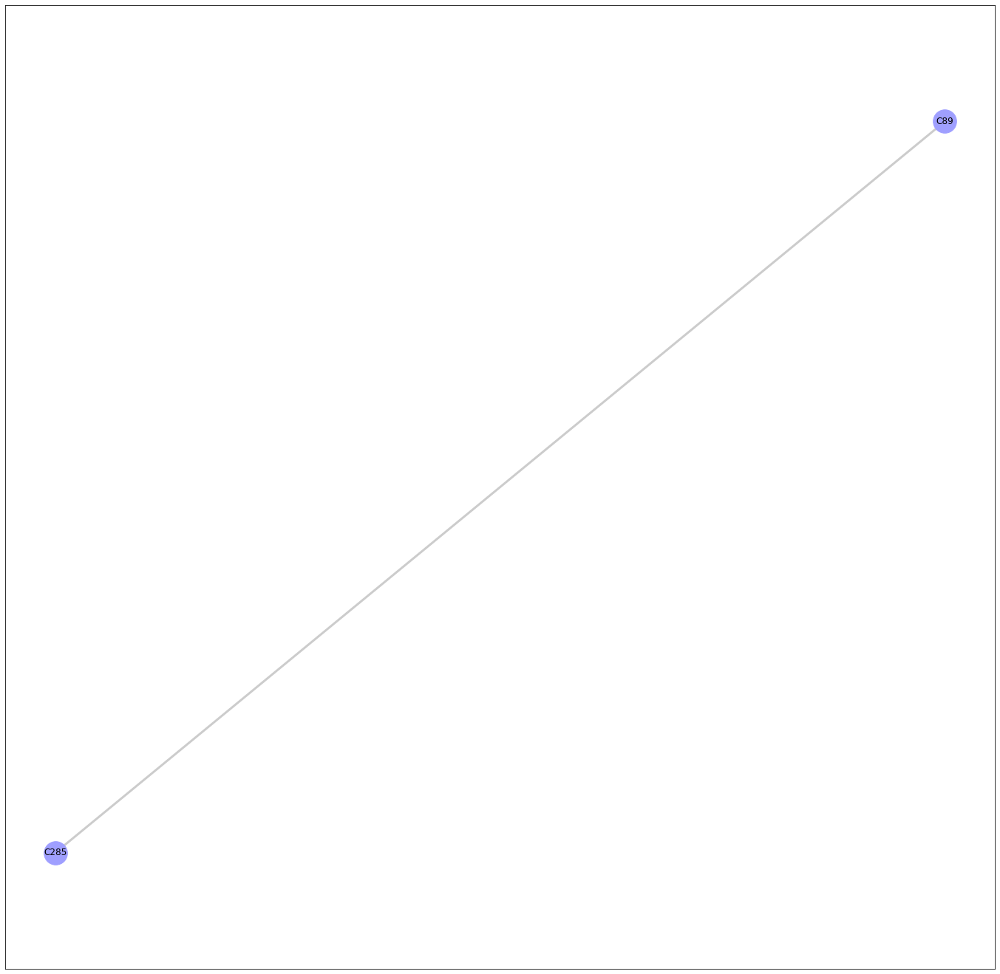

In [46]:
islands = island_method(wcG)
for i in islands:
    # print the threshold level, size of the graph, and number of connected components
    print(i[0], len(i[1]), len(list(nx.connected_components(i[1]))))
    plot_company_node_graph(i[1])